
# End-to-End Multi-Class Dog Bread Classification

This notebook build an end-to-end multi-class image classifier using tensorflow 2.0 and tensorflow hub

## 1. Problem
 > Identifying the bread of a dog. using a given image of a dog.

## 2. Data
Data : https://www.kaggle.com/c/dog-breed-identification/data?select=labels.csv

## 3. Evaluation
The evaluation is a file with prediction probalabilites for each dog breed.

## 4. Features
Some info about data:
* We're going to use images (untructed data) so it probably best that we use Deep Learning / transfer learning
* There are 120 different of dogs.
* There are around 10,000 + images in the traning dataset and test dataset.
* Test dataset dont have labels
* Train dataset have labels

In [1]:
!nvidia-smi

Tue Feb 23 15:55:06 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.39       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla K80           Off  | 00000000:00:04.0 Off |                    0 |
| N/A   72C    P8    34W / 149W |      0MiB / 11441MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
# Unzip the file
# !unzip "/content/drive/MyDrive/dog-vision/dog-breed-identification.zip" -d "/content/drive/MyDrive/dog-vision/"

## Getting our work space ready

* Import Tensorflow 2.x
* Import Tensorflow hub
* Make sure we're using a GPU


In [ ]:
!pip install tensorflow pandas numpy matplotlib pytorch seaborn

  ERROR: Failed building wheel for pytorch
  Running setup.py clean for pytorch
Failed to build pytorch
    Running setup.py install for pytorch ... error
ERROR: Command errored out with exit status 1: /usr/bin/python3 -u -c 'import sys, setuptools, tokenize; sys.argv[0] = '"'"'/tmp/pip-install-60o8vd8a/pytorch/setup.py'"'"'; __file__='"'"'/tmp/pip-install-60o8vd8a/pytorch/setup.py'"'"';f=getattr(tokenize, '"'"'open'"'"', open)(__file__);code=f.read().replace('"'"'\r\n'"'"', '"'"'\n'"'"');f.close();exec(compile(code, __file__, '"'"'exec'"'"'))' install --record /tmp/pip-record-gxmmodig/install-record.txt --single-version-externally-managed --compile Check the logs for full command output.


In [ ]:
# Import tools
import tensorflow_hub as hub
import tensorflow as tf
from sklearn.model_selection import *
from sklearn.metrics import *
print(f'TF Version : {tf.__version__}')
print(f'TF Hub Version : {hub.__version__}')

# Check for GPU avaliability.
print('GPU','avalialbe ( YES :) )' if tf.config.list_logical_devices else 'not available :(')

TF Version : 2.4.1
TF Hub Version : 0.11.0
GPU avalialbe ( YES :) )


## Getting our data ready (turning it to tensors)
With all machine learning models our data should be in numbers. So that is what we are going to do fist turning images to tensors.
Lets start by accessing our data and checking out the labels

In [ ]:
import pandas as pd
labels_csv = pd.read_csv('/content/drive/MyDrive/dog-vision/labels.csv')
labels_csv = labels_csv.sample(frac=1)

In [ ]:
labels_csv.head()

,id,breed
5229,83f0bb565b2186dbcc6a9d009cb26ff2,affenpinscher
1147,1c8d84801448b2a5e352466257197ca1,pembroke
135,0326d40cc2b35521f1f3e73cabcf2a23,lakeland_terrier
512,0c4ac597d196aaf07f3af039b8fd6925,vizsla
8448,d4345a369e8853520659f0dfca8b92d3,miniature_schnauzer


In [ ]:
labels_csv.describe()

,id,breed
count,10222,10222
unique,10222,120
top,75a3eed24c4f6404f12186413372d38d,scottish_deerhound
freq,1,126


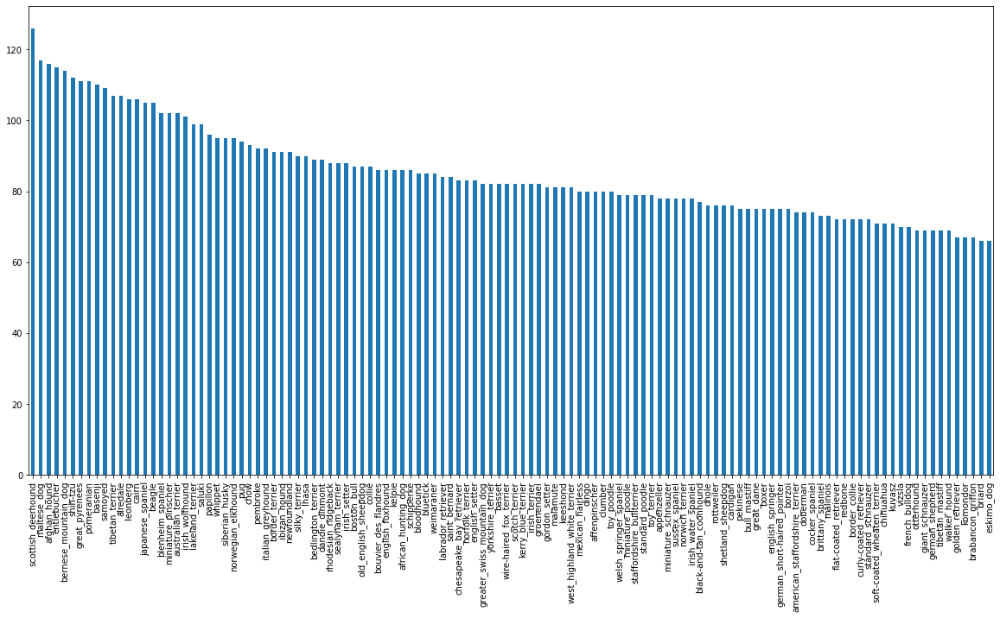

In [ ]:
# Plot the amount of dog breeds datas in labels
labels_csv['breed'].value_counts().plot.bar(figsize=(20,10))

In [ ]:
labels_csv['breed'].value_counts().mean()

85.18333333333334

In [ ]:
# Lets view an Image
from IPython.display import Image
# Image('/content/drive/MyDrive/dog-vision/train/000bec180eb18c7604dcecc8fe0dba07.jpg')
# /content/drive/MyDrive/dog-vision/test

## Getting Images and their labels

Lets get a list of all of our image file path names

In [ ]:
labels_csv.head()

,id,breed
5229,83f0bb565b2186dbcc6a9d009cb26ff2,affenpinscher
1147,1c8d84801448b2a5e352466257197ca1,pembroke
135,0326d40cc2b35521f1f3e73cabcf2a23,lakeland_terrier
512,0c4ac597d196aaf07f3af039b8fd6925,vizsla
8448,d4345a369e8853520659f0dfca8b92d3,miniature_schnauzer


In [ ]:
# Create pathnames from image ID's
filenames = [f"/content/drive/MyDrive/dog-vision/train/{fname}.jpg" for fname in labels_csv['id']]
filenames[:5]

['/content/drive/MyDrive/dog-vision/train/83f0bb565b2186dbcc6a9d009cb26ff2.jpg',
 '/content/drive/MyDrive/dog-vision/train/1c8d84801448b2a5e352466257197ca1.jpg',
 '/content/drive/MyDrive/dog-vision/train/0326d40cc2b35521f1f3e73cabcf2a23.jpg',
 '/content/drive/MyDrive/dog-vision/train/0c4ac597d196aaf07f3af039b8fd6925.jpg',
 '/content/drive/MyDrive/dog-vision/train/d4345a369e8853520659f0dfca8b92d3.jpg']

In [ ]:
import os
# Check wheather number of filenames matches number of actual image files
# if len(filenames) == len(os.listdir('/content/drive/MyDrive/dog-vision/train')):
#   print('OK')

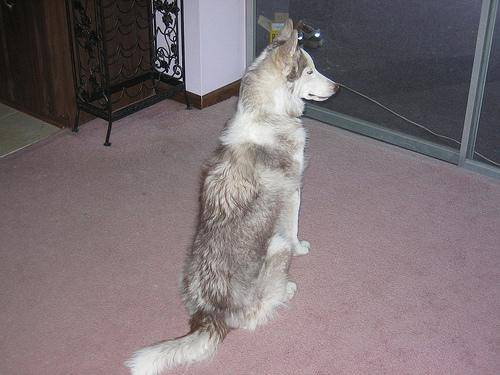

In [ ]:
# One more check
Image(filenames[9000])

Since we have our training filepaths in a list lets prepare our labels

In [ ]:
import numpy as np
labels = labels_csv['breed']
labels = np.array(labels)
labels

array(['schipperke', 'cairn', 'groenendael', ..., 'sealyham_terrier',
       'toy_terrier', 'lhasa'], dtype=object)

In [ ]:
len(os.listdir('/content/drive/MyDrive/dog-vision/train/'))

10222

In [ ]:
# len(os.listdir('/content/drive/MyDrive/dog-vision/test/'))

In [ ]:
if len(labels) == len(filenames):
  print('OK')

OK


In [ ]:
# Find the uniqure label values
unique_breeds = np.unique(labels)

In [ ]:
len(unique_breeds)

120

In [ ]:
# Turn a single label into an array of boolenas
print(labels[0])
labels[0] == unique_breeds

schipperke


array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False,  True, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False])

In [ ]:
# Turn everylabel into boolean array
boolean_labels = [label == unique_breeds for label in labels]

In [ ]:
boolean_labels[:1]

[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False,  True, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False])]

In [ ]:
# Example: Turning boolean array into int
print(labels[0]) # original label
print(np.where(unique_breeds == labels[0])) # index where label occures
print(boolean_labels[0].argmax()) #index where label occurs in bool array
print(boolean_labels[0].astype(int)) # there should be 1 there occurs

schipperke
(array([95]),)
95
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]


In [ ]:
print(labels[2])
print(boolean_labels[2].astype(int))

groenendael
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]


In [ ]:
boolean_labels[:2]

[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False,  True, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([False, False, False, False, False, Fal

In [ ]:
filenames[:10]

['/content/drive/MyDrive/dog-vision/train/0e934073a6b9505c0ded4e34437ca538.jpg',
 '/content/drive/MyDrive/dog-vision/train/0dd1914e122292dfbb25e35537b511f6.jpg',
 '/content/drive/MyDrive/dog-vision/train/41ad1e6c01fa12d530a1122faaeb2917.jpg',
 '/content/drive/MyDrive/dog-vision/train/edafef97d647ec7c4b4e00ed5fd3dde5.jpg',
 '/content/drive/MyDrive/dog-vision/train/e89e6cbb5d616ef9904675b9e6db06b3.jpg',
 '/content/drive/MyDrive/dog-vision/train/5e7623086296cd0a772170bac48381b3.jpg',
 '/content/drive/MyDrive/dog-vision/train/2f820fe3659cb09e5003d37cb7853ea5.jpg',
 '/content/drive/MyDrive/dog-vision/train/4023851ba15301e077734449d0c78eba.jpg',
 '/content/drive/MyDrive/dog-vision/train/4d0d137c835a8be210a53d6c07acc9df.jpg',
 '/content/drive/MyDrive/dog-vision/train/8cfc893064157fb61fc90bf9a5ab14dd.jpg']

## Creating our own validation set
Since the dataset from kaggle doesnt come with validation dataset we are going to make one of our own. :)

In [ ]:
# Setup X & y vals
X = filenames
y = boolean_labels

In [ ]:
len(X)

10222

In [ ]:
len(y)

10222

We are going to start off experimenting with 2500 images and increase as needed.

In [ ]:
# Set number of images to use for experiemnting
NUM_IMAGES = 2500 #@param {type:"slider", min:1000, max:10222, step:500}

In [ ]:
# Split them into trainning and validation of total size NUM_IMAGES
X_train,X_val,y_train,y_val = train_test_split(X[:NUM_IMAGES],y[:NUM_IMAGES],test_size=0.25,random_state=42)

In [ ]:
len(X_train)

1875

In [ ]:
len(y_train)

1875

In [ ]:
len(X_val)

625

In [ ]:
len(y_val)

625

In [ ]:
# Lets have a geez at the traning data
X_train[:5],y_train[:2]

(['/content/drive/MyDrive/dog-vision/train/91af963a2f4cc1b5ab4f7e5d257b4830.jpg',
  '/content/drive/MyDrive/dog-vision/train/abb194f697f5e00bc8be1e29c54ec3d7.jpg',
  '/content/drive/MyDrive/dog-vision/train/b7ee7633af99443dcad5d24677f36404.jpg',
  '/content/drive/MyDrive/dog-vision/train/ca7befe874fe442e48d5cf546b2e5dcb.jpg',
  '/content/drive/MyDrive/dog-vision/train/eaea761df48d7adef74af9c66a0fbf4c.jpg'],
 [array([False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False,  True, False, False, False,
         Fals

## Preproccessing Images (turning Images into tensors)
To preproccess our images into tensors we are goijg to write a funtion to do a few things:
1. Take an Image filepath as input
2. use tenseoflow to read the file and save it to a var
3. then we want to turn the read image into tensors.
4. Resize the `image` to be shape of (224,224)
5. the return the modified `image`

Before we do, lets test this out :)

In [ ]:
# Convert a image to a numpy array
from matplotlib.pyplot import imread
image = imread(filenames[42])
image.shape # height,width,color channel

(333, 500, 3)

In [ ]:
# Turn image to tensor
tf.constant(image)[:2]

<tf.Tensor: shape=(2, 500, 3), dtype=uint8, numpy=
array([[[90, 66, 38],
        [90, 66, 38],
        [90, 66, 38],
        ...,
        [92, 94, 89],
        [90, 92, 87],
        [89, 91, 86]],

       [[91, 67, 39],
        [91, 67, 39],
        [92, 68, 40],
        ...,
        [96, 98, 93],
        [94, 96, 91],
        [93, 95, 90]]], dtype=uint8)>

In [ ]:
image.max(),image.min()

(255, 0)

1. Take an Image filepath as input
2. use tenseoflow to read the file and save it to a var
3. then we want to turn the read image into tensors.
4. Normallize our image (convert the color vals from 0-255 to 0-1)
5. Resize the `image` to be shape of (224,224)
6. the return the modified `image`

In [ ]:
# The image size
IMG_SIZE = 224 #@param

# Create a funtion to preproccess images
def proccess_image(image_path):
  """
  Takes and images file path and turn it to a tensor
  """
  # Read the image file
  image = tf.io.read_file(image_path)
  # Turn the .jpg image to int tensor with 3 color channels (Red,Green,Blue)
  image = tf.image.decode_jpeg(image,channels=3)
  # Convert the color channel values from 0-255 to 0-1 values
  image = tf.image.convert_image_dtype(image,tf.float32)
  # Resize the image
  image = tf.image.resize(image,size=(IMG_SIZE,IMG_SIZE))
  return image

In [ ]:
image = tf.io.read_file(filenames[0])

In [ ]:
image

<tf.Tensor: shape=(), dtype=string, numpy=b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00\x00\x01\x00\x01\x00\x00\xff\xdb\x00C\x00\n\x07\x07\x08\x07\x06\n\x08\x08\x08\x0b\n\n\x0b\x0e\x18\x10\x0e\r\r\x0e\x1d\x15\x16\x11\x18#\x1f%$"\x1f"!&+7/&)4)!"0A149;>>>%.DIC<H7=>;\xff\xdb\x00C\x01\n\x0b\x0b\x0e\r\x0e\x1c\x10\x10\x1c;("(;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;\xff\xc0\x00\x11\x08\x01\xf4\x01w\x03\x01"\x00\x02\x11\x01\x03\x11\x01\xff\xc4\x00\x1f\x00\x00\x01\x05\x01\x01\x01\x01\x01\x01\x00\x00\x00\x00\x00\x00\x00\x00\x01\x02\x03\x04\x05\x06\x07\x08\t\n\x0b\xff\xc4\x00\xb5\x10\x00\x02\x01\x03\x03\x02\x04\x03\x05\x05\x04\x04\x00\x00\x01}\x01\x02\x03\x00\x04\x11\x05\x12!1A\x06\x13Qa\x07"q\x142\x81\x91\xa1\x08#B\xb1\xc1\x15R\xd1\xf0$3br\x82\t\n\x16\x17\x18\x19\x1a%&\'()*456789:CDEFGHIJSTUVWXYZcdefghijstuvwxyz\x83\x84\x85\x86\x87\x88\x89\x8a\x92\x93\x94\x95\x96\x97\x98\x99\x9a\xa2\xa3\xa4\xa5\xa6\xa7\xa8\xa9\xaa\xb2\xb3\xb4\xb5\xb6\xb7\xb8\xb9\xba\xc2\xc3\xc4\xc5\xc6\xc7\xc8\xc9\xca

In [ ]:
image = tf.image.decode_jpeg(image,channels=3)

In [ ]:
tf.image.convert_image_dtype(image,tf.float32)[:2]

<tf.Tensor: shape=(2, 375, 3), dtype=float32, numpy=
array([[[0.11764707, 0.16078432, 0.14509805],
        [0.1137255 , 0.15686275, 0.14117648],
        [0.10196079, 0.14117648, 0.13725491],
        ...,
        [0.7490196 , 0.7372549 , 0.67058825],
        [0.8196079 , 0.8078432 , 0.7411765 ],
        [0.89019614, 0.8745099 , 0.82745105]],

       [[0.12156864, 0.16470589, 0.14901961],
        [0.12156864, 0.16470589, 0.14901961],
        [0.10196079, 0.14117648, 0.13725491],
        ...,
        [0.81568635, 0.80392164, 0.7372549 ],
        [0.8862746 , 0.8745099 , 0.8078432 ],
        [0.94117653, 0.9294118 , 0.8705883 ]]], dtype=float32)>

# Turning our data into batches

Why turn our data into batches ? 

Lets say youre trying to proccess 10,000 + images in one go.. they all might not fit into memeory.

So thats why we do about 32 (batch size) images at a time you can manually change the size

In order to use tensorflow efficentively, we need our data in the form of tensor tupess which look like `(image,label)`

In [ ]:
BATCH_SIZE = 32 #@param

In [ ]:
#  Create a simple funtion to return a tupe (image,label)
def get_image_label(image_path,label):
  image = proccess_image(image_path=image_path)
  return image,label

In [ ]:
(proccess_image(X[42]),y[42])

(<tf.Tensor: shape=(224, 224, 3), dtype=float32, numpy=
 array([[[0.3509279 , 0.26073182, 0.13916317],
         [0.3538953 , 0.25977767, 0.14997375],
         [0.3412619 , 0.2592241 , 0.14612885],
         ...,
         [0.3705269 , 0.39013478, 0.36660534],
         [0.35616243, 0.3757703 , 0.3483193 ],
         [0.34590325, 0.36551112, 0.3380601 ]],
 
        [[0.35972515, 0.26952907, 0.14796044],
         [0.36258754, 0.2684699 , 0.15866597],
         [0.34733018, 0.26529238, 0.15219714],
         ...,
         [0.37635678, 0.39596462, 0.37243518],
         [0.359445  , 0.37905288, 0.35160187],
         [0.34918582, 0.36879367, 0.3413427 ]],
 
        [[0.35568768, 0.2654916 , 0.14392297],
         [0.35908616, 0.2649685 , 0.15516457],
         [0.34644428, 0.26440647, 0.15131123],
         ...,
         [0.3850122 , 0.40462005, 0.38109064],
         [0.35574228, 0.37535012, 0.34789914],
         [0.3430672 , 0.36267504, 0.33522406]],
 
        ...,
 
        [[0.03444513, 0.0383667 

Now we've got a way to turn our data into tupes of tensors in the form : `(image,label)`, lets make a funtion to turn all of our data `(X,y)`

In [ ]:
BATCH_SIZE = 32


In [ ]:
# Create a funtion to turn data into batch
def create_data_batches(X,y=None,batch_Ssize=BATCH_SIZE,valid_data=False,test_data=False):
  """
  Creates batches of data our of image (X) and label (y) paris.
  Shuffles the data if its training data but doesnt shuffle if it's validation data.
  Also accepts test data as input(no labels)
  """
  # If the data is a test dataset, we probably dont have labels
  if test_data:
    print('Creating test data batches...')
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X))) # only file paths (no labels)
    data_batch = data.map(proccess_image).batch(batch_size)
    print(len(data_batch))
    return data_batch
  # If the data is valid dataset we dont need to shuffle it
  elif valid_data:
    print('Creating validation data batches')
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X),
                                              tf.constant(y)))
    data_batch = data.map(get_image_label).batch(BATCH_SIZE)
    return data_batch
  else:
    print('Creating training data batch..')
    # Turn filepaths and labels into tensors
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X),tf.constant(y)))
    # Shuffle pathnames and labels before mapping image proccessor funtion is faster thank shuffle
    data = data.shuffle(buffer_size=len(X))
    # Create (image,label) tupes (this a;so turns the image path nto a preprocessed image)
    data = data.map(get_image_label)
    data_batch = data.batch(BATCH_SIZE)
    return data_batch

In [ ]:
train_data = create_data_batches(X_train,y_train)
val_data = create_data_batches(X_val,y_val,valid_data=True)

Creating training data batch..
Creating validation data batches


In [ ]:
train_data.element_spec

(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
 TensorSpec(shape=(None, 120), dtype=tf.bool, name=None))

In [ ]:
train_data

<BatchDataset shapes: ((None, 224, 224, 3), (None, 120)), types: (tf.float32, tf.bool)>

## Visualizgin Data Batches

Our data is now in batches but these are a bit hard to understand

In [ ]:
import matplotlib.pyplot as plt

# Create a funtion for viewing images in a data batch

def show_25_image(images,labels):
  """
  Disaplys a plot of 25 images of dogs and there labels
  """
  # Setup
  plt.figure(figsize=(20,15))
  # Loop through 25
  for i in range(25):
    # Create subplots (5 rows 5 coloums)
    ax = plt.subplot(5,5,i+1)
    # Display an image
    plt.imshow(images[i])
    # Add the image labels as the title
    plt.title(unique_breeds[labels[i].argmax()])
    # Turn the grid lines off
    plt.axis('off')

In [ ]:
train_images,train_labels = next(train_data.as_numpy_iterator())
train_images,train_labels

(array([[[[0.06553653, 0.25728294, 0.3121849 ],
          [0.05699437, 0.24001853, 0.29355493],
          [0.21923862, 0.3804081 , 0.4359403 ],
          ...,
          [0.38727102, 0.63432986, 0.7009965 ],
          [0.26031697, 0.5073758 , 0.57404244],
          [0.1552137 , 0.40227252, 0.46893921]],
 
         [[0.06455708, 0.25924152, 0.312988  ],
          [0.05427233, 0.23739372, 0.29017702],
          [0.3139062 , 0.47805715, 0.5329188 ],
          ...,
          [0.32270637, 0.5687955 , 0.635947  ],
          [0.2790965 , 0.5238444 , 0.5916665 ],
          [0.3095931 , 0.554341  , 0.6221632 ]],
 
         [[0.06301397, 0.26760083, 0.31665543],
          [0.03113932, 0.21349756, 0.26389337],
          [0.35595113, 0.53189933, 0.58484614],
          ...,
          [0.2522913 , 0.49605903, 0.5643712 ],
          [0.19204134, 0.43125704, 0.50184524],
          [0.16897713, 0.40819284, 0.47878107]],
 
         ...,
 
         [[0.8773042 , 0.83416694, 0.8655395 ],
          [0.87773

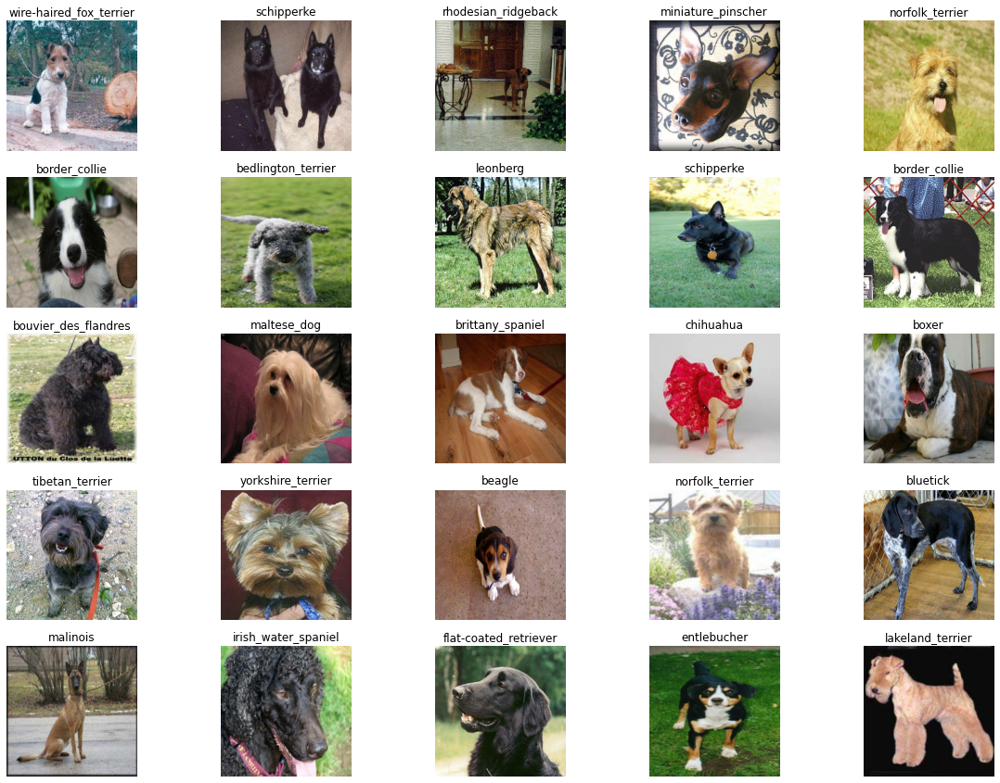

In [ ]:
# Lets vidualize the data
show_25_image(train_images,train_labels)

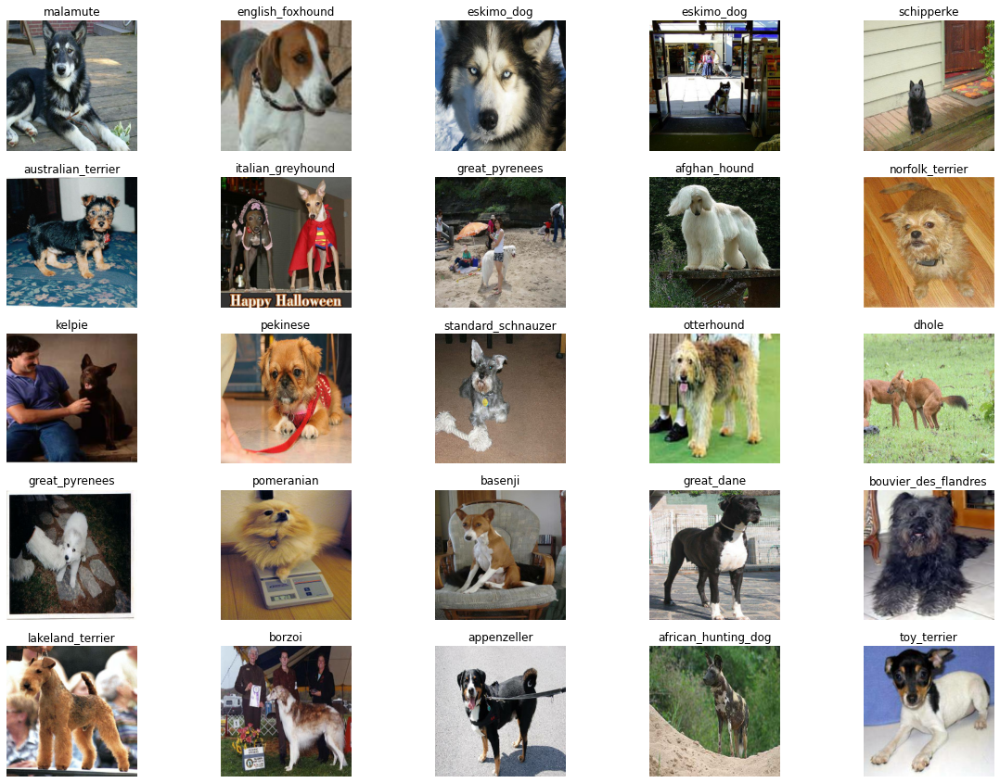

In [ ]:
# Now lets visualize our validation set
val_images,val_labels = next(val_data.as_numpy_iterator())
show_25_image(val_images,val_labels)

# Bulding a model !!!!!! :) :) !!!!


Before we build a model,there are a few things we need to define:
* The input shape (ur images shape, in the form of tensors) to our model
* The output shape (image labels, in the form of tensors) of our model
* The url of the model from tensorflow hub. https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4

In [ ]:
# Input shape
INPUT_SHAPE = [None,IMG_SIZE,IMG_SIZE,3] # batch,height,width,colour channels

# Output shape
OUTPUT_SHAPE = len(unique_breeds)

# Setup model URL from tensorflow hub
MODEL_URL = "https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4"

In [ ]:
len(unique_breeds)

120

Now we got our inputs, outputs and model ready to go.
Lets put them togther into a Keras deep learning model.

Knowing this,lets create a funtion:
* TAKES THE INPUT SHAPE, OUTPUT SHAPE AND THE MODEL WE'VE CHOSSEN AS PARMETER.
* DEFINE THE LAYERS IN A KERAS MODEL IN SQUENTIAL FASHION. (TO THIS THEN DO THAT)
* COMPILES THE MODEL (SAYS IT SHOULD BE EVALUATED)
* BUILDS THE MODEL
* RETURNS THE MODEL

All of these steps can be found https://www.tensorflow.org/tutorials kreas

In [ ]:
# Create a funtion which builds a keras model
def create_model(input_shape=INPUT_SHAPE,output_shape=OUTPUT_SHAPE,model_url=MODEL_URL):
  print(f'Bulding model with:{model_url}')
  # Setup layers (model)
  model = tf.keras.Sequential([
    hub.KerasLayer(model_url), # Layer 1 (INPUT LAYER)
    tf.keras.layers.Dense(units=OUTPUT_SHAPE,
                          activation='softmax'), # Layer 2 (output layer)
  ])
  # Compile the model
  model.compile(
      loss=tf.keras.losses.CategoricalCrossentropy(),
      optimizer=tf.keras.optimizers.Adam(),
      metrics=['accuracy']
  )
  model.build(INPUT_SHAPE)
  return model

In [ ]:
model = create_model()

Bulding model with:https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4


In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
keras_layer (KerasLayer)     (None, 1001)              5432713   
_________________________________________________________________
dense (Dense)                (None, 120)               120240    
Total params: 5,552,953
Trainable params: 120,240
Non-trainable params: 5,432,713
_________________________________________________________________


## Creating callbacks

Callaacks are helper funtions a model can use during a training to do such things as save its progress and check its accuracy and learning rate and other maetrixs.

We'll create 2 callbacks, one for tensorboard which helps to track progress (like W&B) and another one for early stopping which prevents our model not training for too much time.

### TensorBoard Callback
To set up a Tensorboard call back we need to do 3 things:
1. Load the tensorboard notebook extention
2. Create a tensorboard callback which is able to save logs to a directory. and pass it to our models `fit()` funtion.
3. Visualize our models training logs with the `%tensorboard` magic funtion

In [ ]:
# Load tensorboard notebook extention
%load_ext tensorboard

In [ ]:
import datetime

# Create a funtion to build a tensorboard callback
def create_tesnroboard_callback():
  # Create a log directory for storying tensorboard logs
  logdir = os.path.join('/content/drive/MyDrive/dog-vision/logs',datetime.datetime.now().strftime('%Y%m%d-%H%M%S')) # Make it so the logs get tracked whenever we run a experiment
  return tf.keras.callbacks.TensorBoard(logdir)

### Early stopping callback

Early stopping helps stop our model from overfitting by stopping training

In [ ]:
# Create early stopping callbacks
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy',patience=5)

## Training a model (on subset of data)

Our first model is going to train in 2500 images, to make sure everything is good

In [ ]:
NUM_EPOCH = 500 #@param {type:"slider",max:2500,min:100}

In [ ]:
!nvidia-smi

Mon Feb 22 10:55:29 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.39       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   58C    P0    29W /  70W |    286MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
# Check if a GPU is available
print('GPU' if tf.config.list_physical_devices('GPU') else 'No')

GPU


Lets create a fntion which trains a model

* Create a model using `create_model()`
* Setup a tensorboard callback using `create_tensorboard_callback()`
* Call the `fit()` funtion on our passing it the training data, validation data,number of epochs and the heper funtions
* Return the model

In [ ]:
# Build a funtions to train and return a trained model
def train_model():
  """
  Trains a given model and returns a trained version
  """
  # Create model
  model = create_model()

  # Create a new tensroboard session everytime we train a model
  tensorboard = create_tesnroboard_callback()

  # Fit the model to the data passing it the callbacks we created
  model.fit(x=train_data,epochs=NUM_EPOCH,validation_data=val_data,validation_freq=1,callbacks=[tensorboard,early_stopping])

  # Return the model
  return model

In [ ]:
%tensorboard --logdir /content/drive/MyDrive/dog-vision/logs

<IPython.core.display.Javascript object>

In [ ]:
model = train_model()

Bulding model with:https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4
Epoch 1/500
 1/59 [..............................] - ETA: 25:00 - loss: 5.7493 - accuracy: 0.0625

## Checking the tensorboard logs
/content/drive/MyDrive/dog-vision/logs

The tensorboard magic funtion `%tensorbard` will access the logs directory and visualize the infomation

In [ ]:
%tensorboard --logdir /content/drive/MyDrive/dog-vision/logs

## Creating and evaluating predictions using a trained model

In [ ]:
val_data

In [ ]:
# Make predictions predictions in validation data (not used to train on)
predictions = model.predict(val_data, verbose=1)
predictions

In [ ]:
predictions.shape

In [ ]:
len(y_val)

In [ ]:
len(unique_breeds)

In [ ]:
len(X_val)

In [ ]:
# First prediction
index = 65
print(f'Max value (probability of prediction) {np.max(predictions[index])*100}%')  
print(f'Sum : {np.sum(predictions[index])}')
print(f'Max index : {np.argmax(predictions[index])}') 
print(f'Predictied label {unique_breeds[np.argmax(predictions[index])]}')
print(f'The label that should be predicted {unique_breeds[y_val[index].argmax()]}')
Image(X_val[index])

In [ ]:
X_val[0]

In [ ]:
unique_breeds[y_val[0].argmax()]

Having the above funtionality is great but we want to do it at scale.

**Note:** Prediction probabilites are also know as confidence levels

In [ ]:
# Turn predictions probabilites into their respective label (easy to understand)
def get_preds_label(prediction_probability):
  """
  Turns an array of prediction probas into a label
  """
  return unique_breeds[np.argmax(prediction_probability)]

# Example
pred_label = get_preds_label(predictions[81])
pred_label

Since our validation data is still in a batch datase
we need to un batch it to make predictions on the validation images and tehn compare those predsictions to validation labels

In [ ]:
# Create a funtion to unbatch a batch dataset
def unbatch(data):
  """
  Takes a batched data set of (image,label) Tensors and return spearate arrays of images and labels.
  """
  images = []
  labels = []
  for image,label in data.unbatch().as_numpy_iterator():
    images.append(image)
    labels.append(unique_breeds[np.argmax(label)])
  return images,labels

val_images,val_labels = unbatch(val_data)

In [ ]:
get_preds_label(val_labels[0])

Now we've got ways to get:
* Predictions labels
* Truth labels
* Validation images

Lets make all a bit visualize

We'll create a funtion which:
* Takes an array of predictions probabilities and a array of truth labels and and array of images and integers.
* Convert the prediction probs to a predicted label.
* Plot the predicted label,its predicted probability,the truth label and the target images on a singe plot.

In [ ]:
def plot_pred(prediction_probs,labels,images, n=1):
  """
  View the predictions and ground truth and images for sample n
  """
  pred_prob,true_label,image = prediction_probs[n],labels[n],images[n]
  # Get pred label
  pred_label = get_preds_label(pred_prob)
  # Plot image
  plt.imshow(image)
  plt.xticks([])
  plt.yticks([])
  # Change the color of the title depending if the prediction is right or wrong
  if pred_label == true_label:
    color = 'green'
  else:
    color = 'red'
  # Change the plot title
  plt.title('Predicted : {} | How sure : {:2.0f}% | True : {}'.format(pred_label,np.max(pred_prob)*100,true_label),color=color)

In [ ]:
import random
plot_pred(predictions,val_labels,val_images,n=random.randint(0,250))

Now we've got one funtion to visualize our models top predictions, let make another to view our models top 10 prections

This funtion will:
* Take a input of prediction probabilites array and a ground truth array and an intefear
* Find the prediction using `get_preds_label()`
* Find the top 10
* Plot the top 10

In [ ]:
def plot_pred_conf(prediction_probs,labels,n=1):
  """
  Plus the top 10 heigest prediction along with the truth label for sample n
  """
  pred_prob,true_label = prediction_probs[n],labels[n]
  # Get the predicted label
  pred_label = get_preds_label(pred_prob)
  # Find the top 10 predictions.
  top_10_pred_index = pred_prob.argsort()[-10:][::-1]
  top_10_pred_values = pred_prob[top_10_pred_index]
  top_10_pred_labels = unique_breeds[top_10_pred_index]

  # Setup plot
  top_plot = plt.bar(np.arange(len(top_10_pred_labels)),
                     top_10_pred_values,
                     color='grey')
  plt.xticks(np.arange(len(top_10_pred_labels)),labels=top_10_pred_labels,rotation='vertical')
  # Change color of true label
  if np.isin(true_label,top_10_pred_labels):
    top_plot[np.argmax(top_10_pred_labels == true_label)].set_color("green")
  else:
    pass

In [ ]:
plot_pred_conf(predictions,val_labels,n=random.randint(0,250))

Now we got some funtion to visualize and evaluate our model lets check out a few.

In [ ]:
# Lets check our few predictions and their different_values
i_multi = 560
num_row = 3
num_col = 2
num_img = num_row * num_col
plt.figure(figsize=(10*num_col,5*num_row))
for i in range(num_img):
  plt.subplot(num_row,2*num_col,2*i+1)
  plot_pred(prediction_probs=predictions,labels=val_labels,images=val_images,n=i+i_multi)
  plt.subplot(num_row,2*num_col,2*i+2)
  plot_pred_conf(predictions,val_labels)
plt.tight_layout(h_pad=1.0)
plt.show()

## Saving and reloading a trained model

In [ ]:
# Create a funtion to save a model
def save_model(model,suffix=None,path='drive/MyDrive/dog-vision/models/'):
  """
  Saves a given model in amodels directory and appends a suffix (string)
  """
  modeldir = os.path.join(f'{path}{datetime.datetime.now().strftime("%Y%m%d-%H%M%s")}')
  model_path = modeldir + '-' + suffix + '.h5'
  print('Saving model path...')
  print(model_path)
  model.save(model_path)
  return model_path

In [ ]:
# Create a funtion to load a model
def load_model(model_path):
  """
  Loads a saved model.
  """ 
  print(f'Loading saved model. {model_path}')
  model = tf.keras.models.load_model(model_path,custom_objects={'KerasLayer':hub.KerasLayer})
  return model

In [ ]:
# Now we got funtiojs to save and load models. lets test them !
path = save_model(model,suffix='2500-images-Adam-mv2')

In [ ]:
loaded_1000_image_model = load_model(path)

In [ ]:
loaded_1000_image_model.predict(val_data)

In [ ]:
model.evaluate(val_data)

In [ ]:
loaded_1000_image_model.evaluate(val_data)

## Training a big dog model (on the full dataset)

In [ ]:
len(X)

10222

In [ ]:
len(y)

10222

In [ ]:
X[:2]

['/content/drive/MyDrive/dog-vision/train/0e934073a6b9505c0ded4e34437ca538.jpg',
 '/content/drive/MyDrive/dog-vision/train/0dd1914e122292dfbb25e35537b511f6.jpg']

In [ ]:
y[:2]

[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False,  True, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([False, False, False, False, False, Fal

In [ ]:
# Create a data batch with the full dataset
full_data = create_data_batches(X,y)

Creating training data batch..


In [ ]:
# Create a model
full_model = create_model()

In [ ]:
# Create callbacks (full model)
full_model_tensorboard = create_tesnroboard_callback()
# No validation set when training in all data.
full_model_early_stopping = tf.keras.callbacks.EarlyStopping(monitor='accuracy',patience=5)

In [ ]:
# Running the cell below will take a little while about 30 Min.

In [ ]:
# Fit the full model to the full data
full_model.fit(x=full_data,epochs=NUM_EPOCH,callbacks=[full_model_tensorboard,full_model_early_stopping])

In [ ]:
save_model(full_model,suffix='full-image-set-mv2-Adam-FULL')

In [ ]:
loaded_full_model = load_model("drive/MyDrive/dog-vision/models/20210221-05031613883800-full-image-set-mv2-Adam-FULL.h5")

In [ ]:
len(X)

#Making predictions on test images

Since our model has been trained on images in the form of tensor batches, lets turn the test data to tensor batched also !

* Get the test image filesnames
* Convert the file names into test data batches using `create_data_batches()` and setting the `test_data` to true.
* Make predictions array by passing the test batches to the predict method

In [ ]:
test_path = '/content/drive/MyDrive/dog-vision/test/'
test_filenames = [test_path + fname for fname in os.listdir(test_path)]
test_filenames[:2]

In [ ]:
len(test_filenames)

10357

In [ ]:
# Create test data batch
test_data = create_data_batches(test_filenames,test_data=True)

Creating test data batches...


NameError: ignored

In [ ]:
len(test_data)

In [ ]:
test_data